In [1]:
## ---- load library ----
library(tidyverse)
library(glmnet)
library(dbplyr)
set.seed(123)

## ---- load data ----
got.df <- read_csv('Game_of_Thrones_Script.csv')
glimpse(got.df)

── Attaching packages ─────────────────────────────────────────────────────────── tidyverse 1.3.1 ──

✔ ggplot2 3.3.5     ✔ purrr   0.3.4
✔ tibble  3.1.6     ✔ dplyr   1.0.9
✔ tidyr   1.2.0     ✔ stringr 1.4.0
✔ readr   2.1.2     ✔ forcats 0.5.1

── Conflicts ────────────────────────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()

Loading required package: Matrix


Attaching package: ‘Matrix’


The following objects are masked from ‘package:tidyr’:

    expand, pack, unpack


Loaded glmnet 4.1-3


Attaching package: ‘dbplyr’


The following objects are masked from ‘package:dplyr’:

    ident, sql


Rows: 23911 Columns: 6
── Column specification ────────────────────────────────────────────────────────────────────────────
Delimiter: ","
chr  (5): Season, Episode, Episode Title, Name, Sentence
date (1): Release Date

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify

Rows: 23,911
Columns: 6
$ `Release Date`  <date> 2011-04-17, 2011-04-17, 2011-04-17, 2011-04-17, 2011-…
$ Season          <chr> "Season 1", "Season 1", "Season 1", "Season 1", "Seaso…
$ Episode         <chr> "Episode 1", "Episode 1", "Episode 1", "Episode 1", "E…
$ `Episode Title` <chr> "Winter is Coming", "Winter is Coming", "Winter is Com…
$ Name            <chr> "waymar royce", "will", "waymar royce", "will", "gared…
$ Sentence        <chr> "What do you expect? They're savages. One lot steals a…


In [2]:
View(got.df$Sentence)

[1] "What do you expect? They're savages. One lot steals a goat from another lot and before you know it, they're ripping each other to pieces."                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                       
    [2] "I've never seen wildlings do a thing like this. I've never seen a thing like this, not ever in my life."                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                         
    [3] "How close did you get?"                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                              

In [3]:
## ---- text wrangling ----
got.df <- got.df %>% 
  mutate(season = as.integer(substring(Season, nchar(Season)-1)), # last digit
         episode = as.integer(substring(Episode, 8))) # offset word 'Episode'

got.ls <- apply(got.df, 1, function(x){
  s <- x['Sentence']
  s <- gsub("‘", "'",s) # replace ‘ with '
  s <- gsub('…', ' ',s, fixed = TRUE) # replace … with space
  s <- gsub("...", ' ', s, fixed = TRUE) # replace ... with space
  s <- gsub("“", "'",s, fixed = TRUE) # replace “ with '
  s <- gsub("”", "'",s, fixed = TRUE) # replace ” with '
  ss = tolower(strsplit(s,"[[:blank:][:punct:]]")[[1]])
  return(ss)
})

# sanity check
length(got.ls) == nrow(got.df) # TRUE 

[1] TRUE

In [4]:
## ---- extract all unique words as master list ----
master_words.vt <- unique(unlist(got.ls))
words_indices.ls <- lapply(got.ls, function(x){
  s = match(x, master_words.vt)
  return(s)
})

# sanity check
head(master_words.vt, n=20)
got.ls[[1]]
words_indices.ls[[1]]

[1] "what"    "do"      "you"     "expect"  ""        "they"    "re"     
 [8] "savages" "one"     "lot"     "steals"  "a"       "goat"    "from"   
[15] "another" "and"     "before"  "know"    "it"      "ripping"

[1] "what"    "do"      "you"     "expect"  ""        "they"    "re"     
 [8] "savages" ""        "one"     "lot"     "steals"  "a"       "goat"   
[15] "from"    "another" "lot"     "and"     "before"  "you"     "know"   
[22] "it"      ""        "they"    "re"      "ripping" "each"    "other"  
[29] "to"      "pieces"

[1]  1  2  3  4  5  6  7  8  5  9 10 11 12 13 14 15 10 16 17  3 18 19  5  6  7
[26] 20 21 22 23 24

In [5]:
## ---- load GloVe db ----
con <- dplyr::src_sqlite('~/Downloads/words2.db') # establish connection
glove <- tbl(con, 'glove') # glove table
glove %>% tally() %>% collect()

glimpse(glove)

Warning message:
“`src_sqlite()` was deprecated in dplyr 1.0.0.
Please use `tbl()` directly with a database connection
This warning is displayed once every 8 hours.
Call `lifecycle::last_lifecycle_warnings()` to see where this warning was generated.”


n
<int>
1917494


Rows: ??
Columns: 301
Database: sqlite 3.38.5 [/Users/chase/Downloads/words2.db]
$ Word <chr> ",", "the", ".", "and", "to", "of", "a", "in", "\"", "is", "for",…
$ d001 <dbl> 0.18378000, -0.20838000, 0.10876000, -0.09611000, -0.24837000, -0…
$ d002 <dbl> -0.1212300, -0.1493200, 0.0022438, -0.2578800, -0.4546100, -0.285…
$ d003 <dbl> -0.119870, -0.017528, 0.222130, -0.358600, 0.039227, 0.063387, -0…
$ d004 <dbl> 0.0152270, -0.0284320, -0.1210200, -0.3288700, -0.2842200, -0.601…
$ d005 <dbl> -0.191210, -0.060104, -0.048959, 0.579500, -0.031852, -0.015309, …
$ d006 <dbl> -0.0660740, -0.2646000, 0.0181350, -0.5177400, 0.2635500, 0.07324…
$ d007 <dbl> -2.9876, -4.1445, -3.8174, -4.1582, -4.6323, -3.8547, -4.2485, -3…
$ d008 <dbl> 0.807950, 0.629320, -0.032631, -0.113710, 0.013890, 0.528090, 0.8…
$ d009 <dbl> 0.067338, 0.336720, -0.625940, -0.108480, -0.539280, -0.077859, 0…
$ d010 <dbl> -0.131840, -0.433950, -0.518980, -0.488850, -0.084454, -0.407560,…
$ d011 <dbl> -0.5274000, 0.3989900, -0.

In [6]:
## ---- fit glmnet (same as in W11) ----
## read in human-classfied positive and negative words 
pos_words <- scan('positive-words.txt', 
                  blank.lines.skip = TRUE, comment.char = ";", what = "")
neg_words <- scan('negative-words.txt', 
                  blank.lines.skip = TRUE, comment.char = ";", what = "")
# bag those into training words. 1: positive; 0: negative 
train_words <- tibble(words = c(pos_words, neg_words), 
                      pos = rep(1:0, c(length(pos_words), length(neg_words))))
# copy to db 
train_words <- copy_to(con, train_words, name = 'train_words', 
                       temporary = TRUE, overwrite = TRUE)

# joining with glove 
train.df <- train_words %>% 
  inner_join(glove, by = c('words' = 'Word')) %>% # joining with glove 
  collect()  # bring it back to R.

glimpse(train.df)

Rows: 6,628
Columns: 302
$ words <chr> "like", "good", "well", "great", "free", "work", "best", "love",…
$ pos   <int> 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1…
$ d001  <dbl> -0.0149490, -0.0692540, 0.0882050, -0.0338190, -0.6198400, 0.248…
$ d002  <dbl> 0.17910000, 0.37668000, 0.40155000, 0.27263000, -0.31242000, 0.1…
$ d003  <dbl> -0.288830, -0.169580, -0.044703, -0.203010, 0.399180, -0.118110,…
$ d004  <dbl> -0.3399900, -0.2748200, -0.5097300, -0.2931000, 0.4844200, -0.02…
$ d005  <dbl> -0.030165, 0.256670, 0.116040, 0.104890, 0.174360, -0.192590, 0.…
$ d006  <dbl> 0.00057625, -0.20293000, -0.16130000, -0.21142000, 0.42494000, 0…
$ d007  <dbl> -4.0142, -4.1122, -4.3066, -3.5503, -3.1734, -4.1861, -3.4478, -…
$ d008  <dbl> -0.561890, 0.025950, -0.084823, -0.633350, 0.094000, -0.082146, …
$ d009  <dbl> -0.2453600, -0.2708500, 0.0882310, -0.2828000, -0.4553900, 0.198…
$ d010  <dbl> -0.901960, -0.870030, -0.590670, -0.450470, -0.653360, -0.076370…
$ d011  <dbl> 0

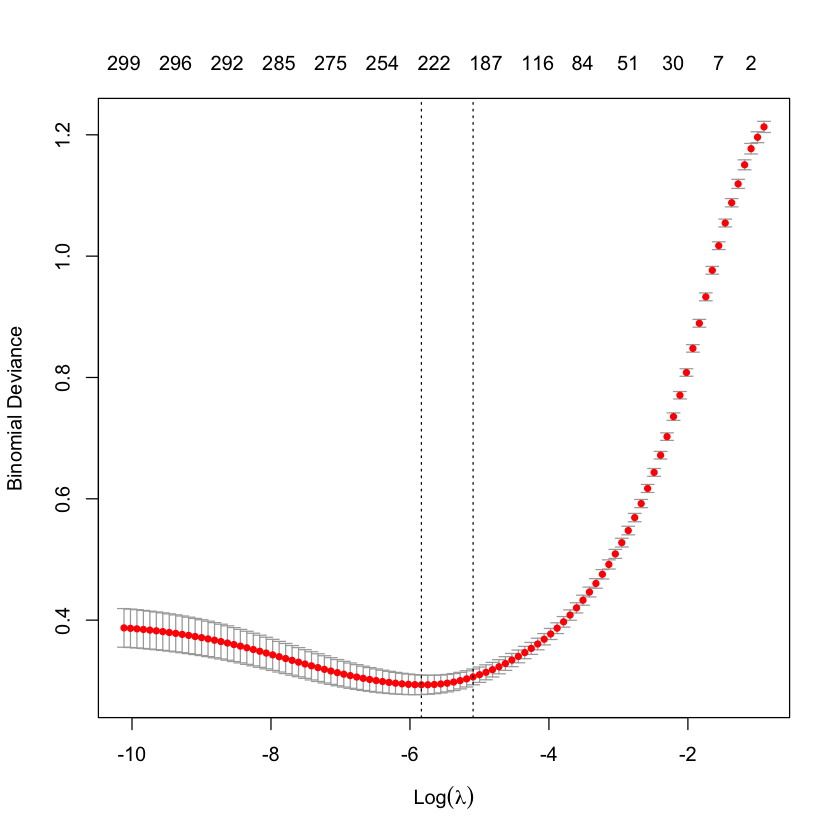

In [7]:
# create design matrix for 'glmnet' 
train_x <- train.df %>% 
  select(-words, -pos) %>% as.matrix()

rownames(train_x) <- train.df$words
# response 
train_y <- train.df$pos

# set test data 
test <- sample(nrow(train_x), nrow(train_x)/5) # 20% as test data

# logistical model with a mix (50/50) mix of L1 and L2 regularisation. 
fit <- cv.glmnet(train_x[-test,], train_y[-test], family = 'binomial', 
                 alpha = 0.5)

# eyeballing the fit 
plot(fit)

In [8]:
## ---- predict sentiments for ALL words in script ----
# copy all words to DB to join with glove
word_tbl <- copy_to(con, 
                    tibble(ALL_WORDS = master_words.vt),
                    name = "temp_words", #create = TRUE,
                    overwrite = TRUE, temporary = TRUE)

word_df <- inner_join(word_tbl, glove, by = c('ALL_WORDS' = 'Word')) %>% 
  collect() 

# check the unmatched master_words -- seems mostly GoT specifics such as  'yunkish'
ss <- master_words.vt[!(master_words.vt %in% word_df$ALL_WORDS)]; View(ss)

# create model matrix for glmnet 
word_x <- word_df %>% 
  select(-ALL_WORDS) %>% 
  as.matrix()

# prediction, one sentiment score for each word.
senti <- predict(fit$glmnet.fit, word_x, s = fit$lambda.min)

senti_master.df <- data.frame(word = master_words.vt, 
                              stringsAsFactors = FALSE) %>%
  left_join(data.frame(word = word_df$ALL_WORDS, sentiment = senti, 
                       stringsAsFactors = FALSE)) #%>% 
  # rename(sentiment = X1) # can be 'S1' instead of 'X1' if using R4.1.x

names(senti_master.df)[2] = 'sentiment'  # update to more meaningful column name

glimpse(senti_master.df)

[1] ""                "mordane"         "horselord"       "grumpkins"      
  [5] "irogenia"        "khals"           "mikken"          "tyroshi"        
  [9] "tarlys"          "rakharo"         "dothrakan"       "arakh"          
 [13] "vroz"            "bloodrider"      "bharbo"          "qohor"          
 [17] "dothrak"         "lannisport"      "horselords"      "dragonglass"    
 [21] "maegor"          "alliser"         "horselordo"      "houndo"         
 [25] "goodfolk"        "redwyne"         "rhaego"          "horseparts"     
 [29] "skycells"        "goatshit"        "orys"            "impunent"       
 [33] "virzetha"        "gizikhven"       "qora"            "braavosi"       
 [37] "tytos"           "childo"          "mormonts"        "olyvar"         
 [41] "maekar"          "gunthor"         "lmpossible"      "wolfswood"      
 [45] "graveworms"      "lnnocent"        "dontos"          "torrhen"        
 [49] "portan"          "lazarheen"       "kovarro"         "rokharo"        
 [53] "frostfangs"      "randyll"         "jhaqo"           "khalasaar"      
 [57] "saltwives"       "saltwife"        "mhaegen"         "podrick"        
 [61] "lommy"           "matthos"         "salladhor"       "pentoshi"       
 [65] "midanese"        "lysene"          "westerosee"      "zuriff"         
 [69] "roado"           "qartheen"        "polliver"        "eddardo"        
 [73] "xhoan"           "soumai"          "mthat"           "dagmer"         
 [77] "maidenpool"      "mooton"          "barrowton"       "longaxes"       
 [81] "haylene"         "dracarys"        "rewove"          "meereenis"      
 [85] "malakko"         "stonesnake"      "sideface"        "marbrand"       
 [89] "brotherfucker"   "lllyrio"         "mopatis"         "maegyr"         
 [93] "rhaenys"         "visenya"         "meraxes"         "vhagar"         
 [97] "karstarks"       "ashemark"        "archmaester"     "shevelathin"    
[101] "shevelatesh"     "chevalteesh"     "foodo"           "vyalthan"       
[105] "rhoyne"          "lorathi"         "thireen"         "gelmarr"        
[109] "urzen"           "stygg"           "seagard"         "faircastle"     
[113] "giantsbane"      "oxcross"         "mallister"       "qyburn"         
[117] "westrosi"        "kraznys"         "thenns"          "hornfoots"      
[121] "anguy"           "warging"         "tobho"           "cowardo"        
[125] "winterhell"      "greizhen"        "missandei"       "twatbeard"      
[129] "meereenese"      "unbesmirched"    "rattleshirt"     "harrion"        
[133] "karhold"         "selyse"          "tommard"         "backstabbings"  
[137] "olyver"          "dareon"          "tormundo"        "hollor"         
[141] "rytsas"          "ritsas"          "yunkish"         "razdal"         
[145] "eraz"            "savageries"      "septons"         "tralalalaleeday"
[149] "prendahl"        "ghezn"           "naharis"         "thowg"          
[153] "vhag"            "enog"            "dothroaki"       "athjahakar"     
[157] "athjahaka"       "hakar"           "feldan"          "tristifer"      
[161] "derwa"           "waldra"          "wertha"          "waldina"        
[165] "jention"         "nūmāzme"         "ēza"             "iderenna"       
[169] "qopsa"           "verdagon"        "queensguard"     "nightfort"      
[173] "jaehaerys"       "hodoring"        "songbirdo"       "desmondo"       
[177] "highborns"       "rylene"          "nigit"           "ghiscari"       
[181] "dornishmen"      "manwoodys"       "kingsgrave"      "dornishman"     
[185] "ellaria"         "leygood"         "kaeth"           "peasebury"      
[189] "musgood"         "elyo"            "worldo"          "madking"        
[193] "heado"           "involvedi"       "kingsguards"     "neverhave"      
[197] "nmight"          "wallto"          "shuty"           "backsoon"       
[201] "trants"          "lhara"           "hizdahr"         "loraq"          
[205] "sweetsleep"      

Joining, by = "word"


Rows: 9,463
Columns: 2
$ word      <chr> "what", "do", "you", "expect", "", "they", "re", "savages", …
$ sentiment <dbl> 1.16079289, -3.99536083, 3.18039751, 1.72456677, NA, -0.1449…


In [9]:
# join back to the sentences in the got.df
sentiment.vt <- sapply(words_indices.ls, function(x){
  senti <- senti_master.df$sentiment[x]
  ave <- mean(senti, na.rm = TRUE)
  return(ave)
})
got.df <- got.df %>% 
  mutate(sentiment = sentiment.vt)

glimpse(got.df)

Rows: 23,911
Columns: 9
$ `Release Date`  <date> 2011-04-17, 2011-04-17, 2011-04-17, 2011-04-17, 2011-…
$ Season          <chr> "Season 1", "Season 1", "Season 1", "Season 1", "Seaso…
$ Episode         <chr> "Episode 1", "Episode 1", "Episode 1", "Episode 1", "E…
$ `Episode Title` <chr> "Winter is Coming", "Winter is Coming", "Winter is Com…
$ Name            <chr> "waymar royce", "will", "waymar royce", "will", "gared…
$ Sentence        <chr> "What do you expect? They're savages. One lot steals a…
$ season          <int> 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, …
$ episode         <int> 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, …
$ sentiment       <dbl> -0.24176478, -0.03472463, 1.30408681, 0.37492382, 0.76…


In [10]:
# ---- explore the data ----
# Q1: most talkative
(top5 <- head(sort(table(got.df$Name), decreasing=TRUE), 5))

top1 <- top5[1]

top5.df <- got.df %>%
    filter(Name %in% rownames(top5)) %>%
    count(Name, Season)


  tyrion lannister           jon snow daenerys targaryen   cersei lannister 
              1760               1133               1048               1005 
   jaime lannister 
               945 

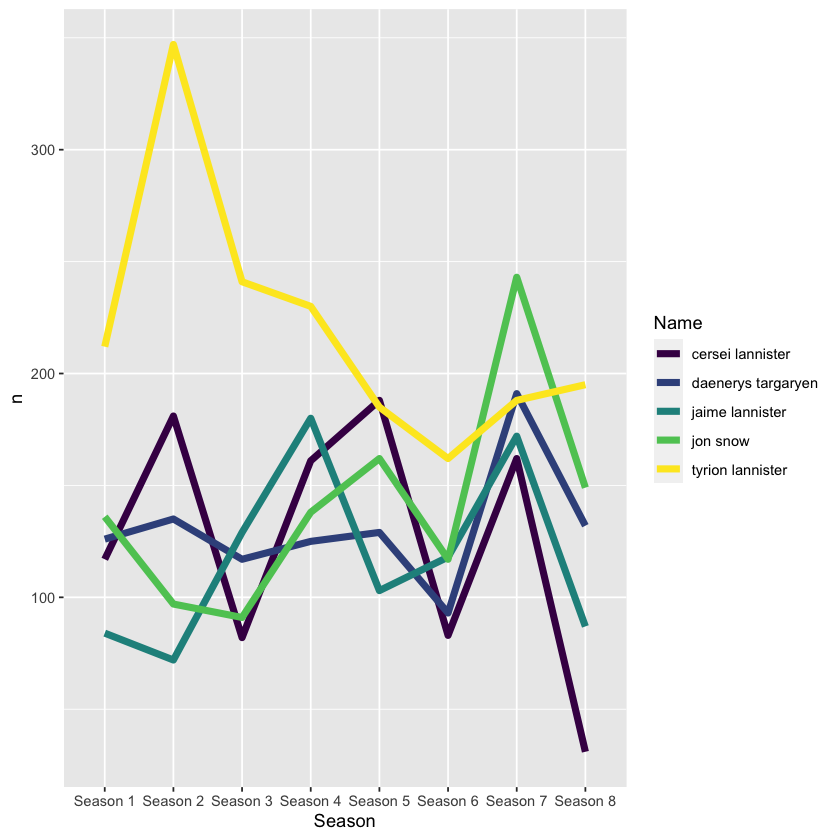

In [11]:
top5.df %>%
    ggplot(aes(x=Season, y=n, group=Name, colour=Name)) +
    geom_line(size=2) +
    scale_colour_viridis_d()

`summarise()` has grouped output by 'Name'. You can override using the `.groups` argument.


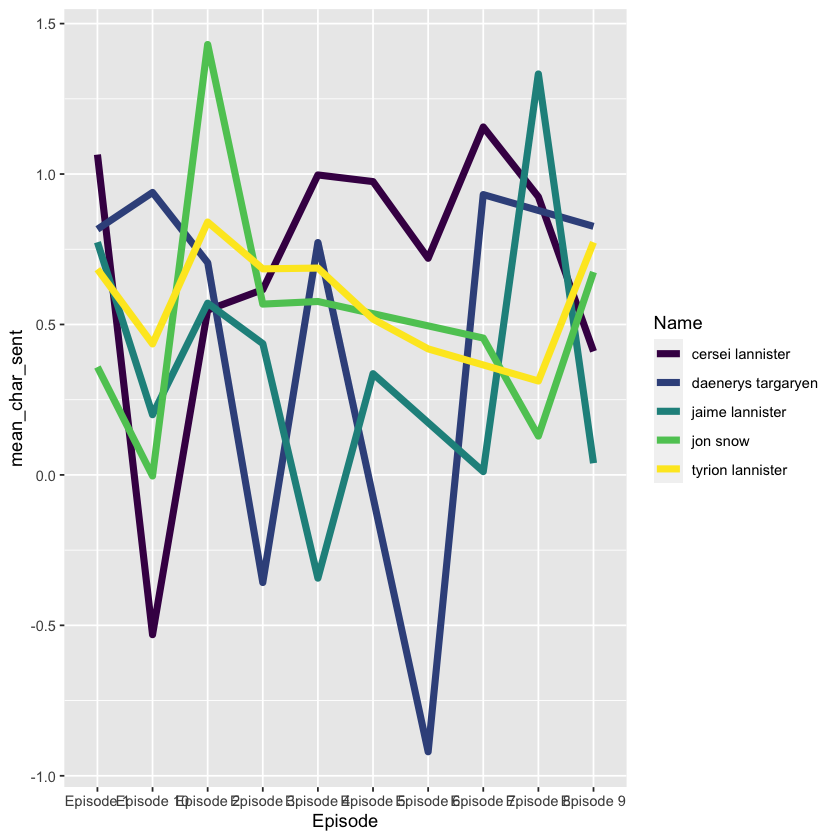

In [12]:
# plot of sentiment score over episode in Season 1.

# Q2: ...

q2.df <- got.df %>%
    filter(Name %in% rownames(top5), Season == 'Season 1') %>%
    group_by(Name, Episode) %>%
    summarise(mean_char_sent = mean(sentiment))

q2.df %>%
    ggplot(aes(x=Episode, y=mean_char_sent, group=Name, colour=Name)) +
    geom_line(size=2) +
    scale_colour_viridis_d()

Warning message:
“Removed 1 rows containing non-finite values (stat_boxplot).”


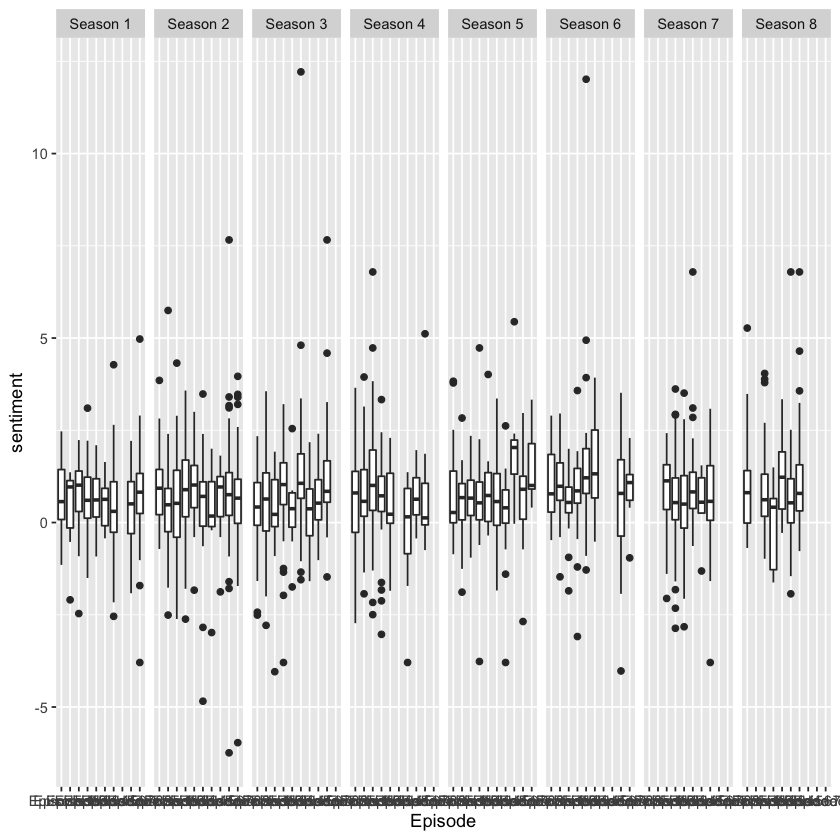

In [13]:
# Q3
ggplot(filter(got.df, Name == 'tyrion lannister'),
      aes(x=Episode, y=sentiment)) +
facet_grid(~Season) +
geom_boxplot()

Tyrion Lannister's sentiment score distribution across episodes and seasons is generally positive, with a slight increase across seasons and a few significant outliers, especially on the positive end.

Loading required package: RColorBrewer

Joining, by = "word"


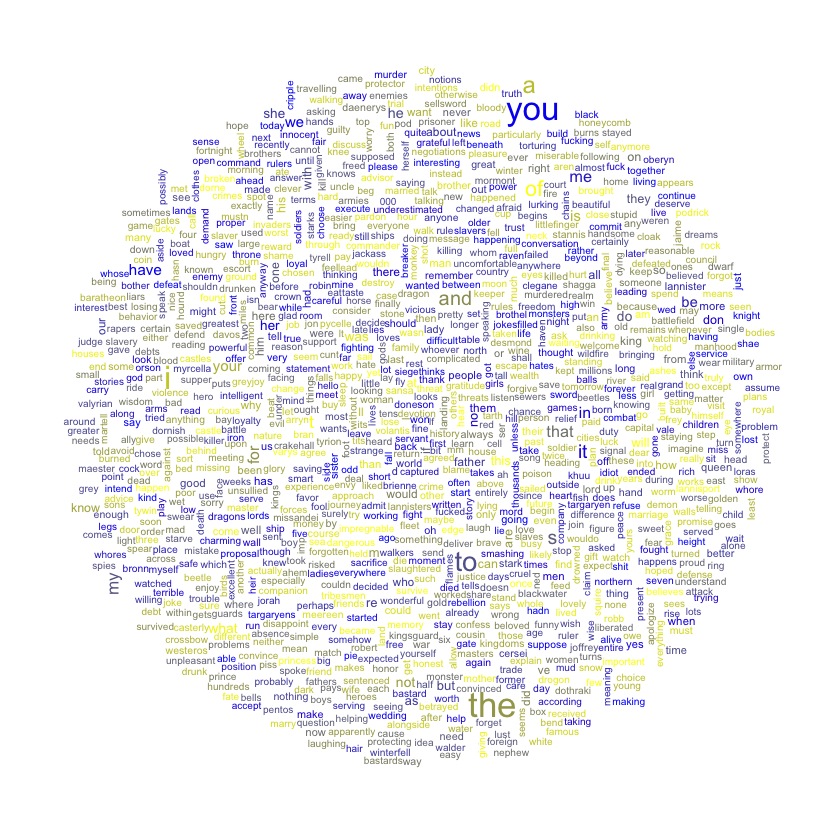

In [14]:
library(wordcloud)

tyrion.words <- unlist(got.ls[got.df$Name == 'tyrion lannister'])
tyrion.freqs <- data.frame(table(tyrion.words)) %>%
    mutate(word=tyrion.words) %>% dplyr::select(-tyrion.words)
tyrion.sent.freqs <- left_join(tyrion.freqs, senti_master.df) %>%
    arrange(sentiment)

wordcloud(words=tyrion.sent.freqs$word, 
          freq=tyrion.sent.freqs$Freq,
          col=colorRampPalette(c("yellow", "blue"))(length(tyrion.sent.freqs$sentiment)),
          ordered.colors=T)